In [371]:
#%%capture trash
#!pip install nd2
#!pip install ipympl
#!pip install plotly
#!pip install jupyter-matplotlib
#!pip install opencv-python
#!pip install scipy
#!pip install sklearn

Applications          Movies                Public
Desktop               Music                 Untitled.ipynb
Documents             Nexxiot AG            all_cleaned_up.png
Downloads             NiceResults.png       all_cleaned_up2.png
DropletCleaning.ipynb OneDrive - Nexxiot AG books_read2.png
Library               Pictures              cleaned_up.png


In [282]:
import nd2
import matplotlib.pyplot as plt
import numpy as np
import matplotlib
from IPython.display import Image
import math

# Grr google collab
%matplotlib inline
matplotlib.rcParams['figure.dpi']= 450

### Parameters

In [369]:
padding_squares = 20

padding_circles_collision = 0
padding_circles_visual = padding_circles_collision

circle_weight_threshold = 0.05
auto_circle_weight_threshold = True

brightness_threshold = 10000
auto_brightness_threhold = True
elimination_threshold = 50
overlap_padding = 20
circle_mask_padding = 10

inpaint_radius = 50

In [284]:
#path = "Downloads/20220722PM_ATTO1_T1_Split1.nd2"
#path = "Downloads/20220722PM_ATTO2_T1_Split1.nd2"
path = "Downloads/20220722PM_Calcein2_T1_Split1.nd2"

#path = "Downloads/20220722PM_CF405S_2_t1.nd2"


#path = "Downloads/20220722PM_SulfoB1_T1_Split2.nd2"


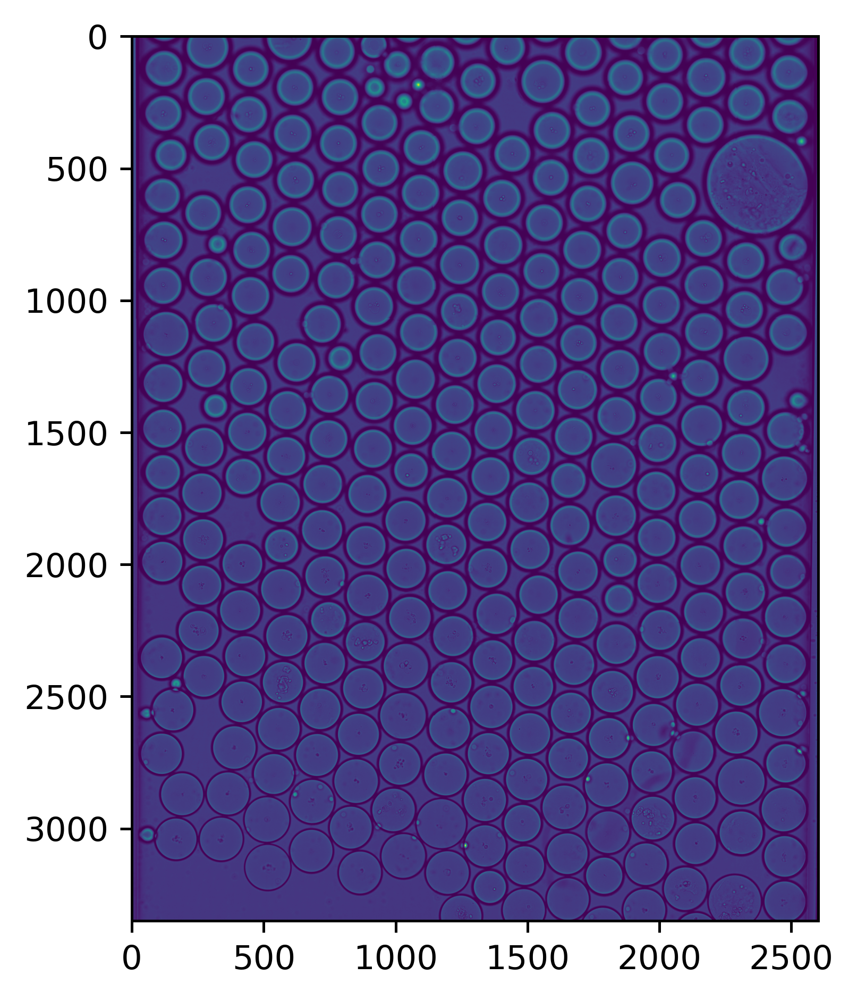

In [285]:
test = nd2.imread(path)[3]
#test[3][test[3] > 12000] = 0

plt.imshow(test)
plt.show()

In [328]:
# Pick a brightness threhold of around 1% of the image

sample = np.random.choice(a=test.flatten(), size=1000000)

if auto_brightness_threhold: 
    brightness_threshold = np.percentile(sample, 99)
    
print('percentage of pixels below brightness threhold')
print(np.sum(sample <= brightness_threshold)/sample.shape[0])
print('selected brightness threshold')
print(brightness_threshold)


percentage of pixels below brightness threhold
0.990016
selected brightness threshold
11860.0


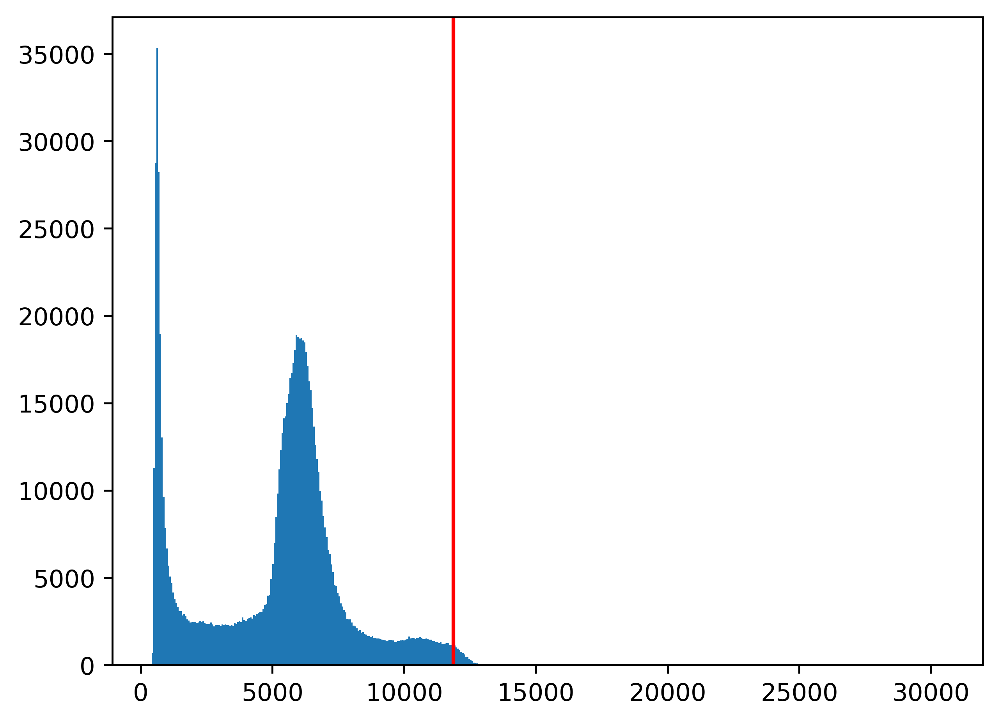

In [329]:
# Plot brightness histogram with threhold
plt.hist(sample, bins = 500)
plt.axvline(x=brightness_threshold, color='r')
plt.show()


# Identify large bright patches

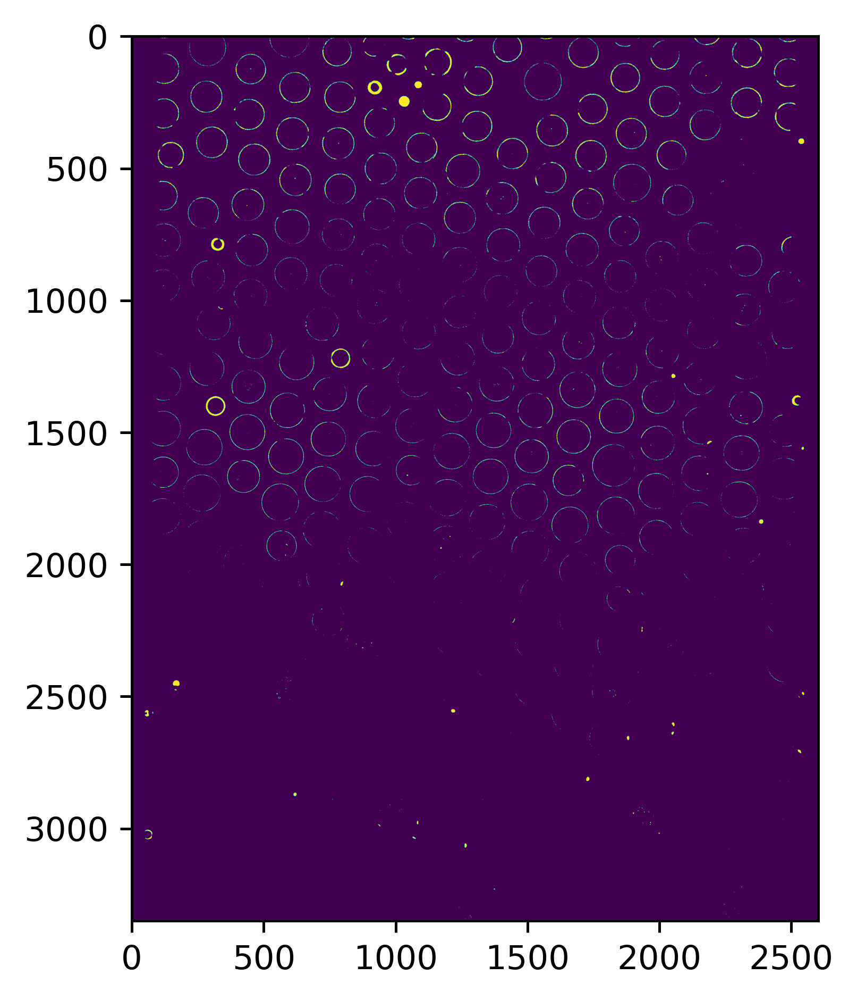

In [331]:
# Create mask of brigtest points
mask = np.zeros(test.shape)

mask[test > brightness_threshold] = 1

plt.imshow(mask)
plt.show()

In [332]:
# dumb way dynamic programming kinda
import sys
from scipy.ndimage import label, generate_binary_structure

sys.setrecursionlimit(1000000)

# Create dummy array to mark visited fields
visited = np.zeros(test[1].shape)
# Store identified objects
objects = []
# Index of current object
curr_object = 0

In [333]:
#identify and mark all fields of an object
# OLD VERISON: TOO MANY LAYERS

#for x in range(np.shape(mask)[0]):
#    for y in range(np.shape(mask)[1]):
#        if visited[x][y] == 1:
#            continue
#        elif mask[x][y] == 0:
#            visited[x][y] = 1
#            continue
#        else: # Spot unvisited and contains marked area
#            found(x, y)

#def found(x_cur, y_cur):
#    left = (max(x_cur-1, 0), y_cur)
#    right = (min(x_cur+1, np.shape(mask)[0]), y_cur)
#    top = (x_cur ,max(y_cur-1, 0))
#    bottom = (x_cur, min(y_cur+1, np.shape(mask)[1]))
#    for coord in [left, right, top, bottom]:
#        visited[coord[0]][coord[1]] = 1
#        if mask[coord[0]][coord[1]] == 1:
#            # Recursion!
#            found(coord[0], coord[1])
#        # Else its not in the object and we can ignore
   

In [334]:
#identify and mark all fields of an object
labeled_features, num_features = label(mask)

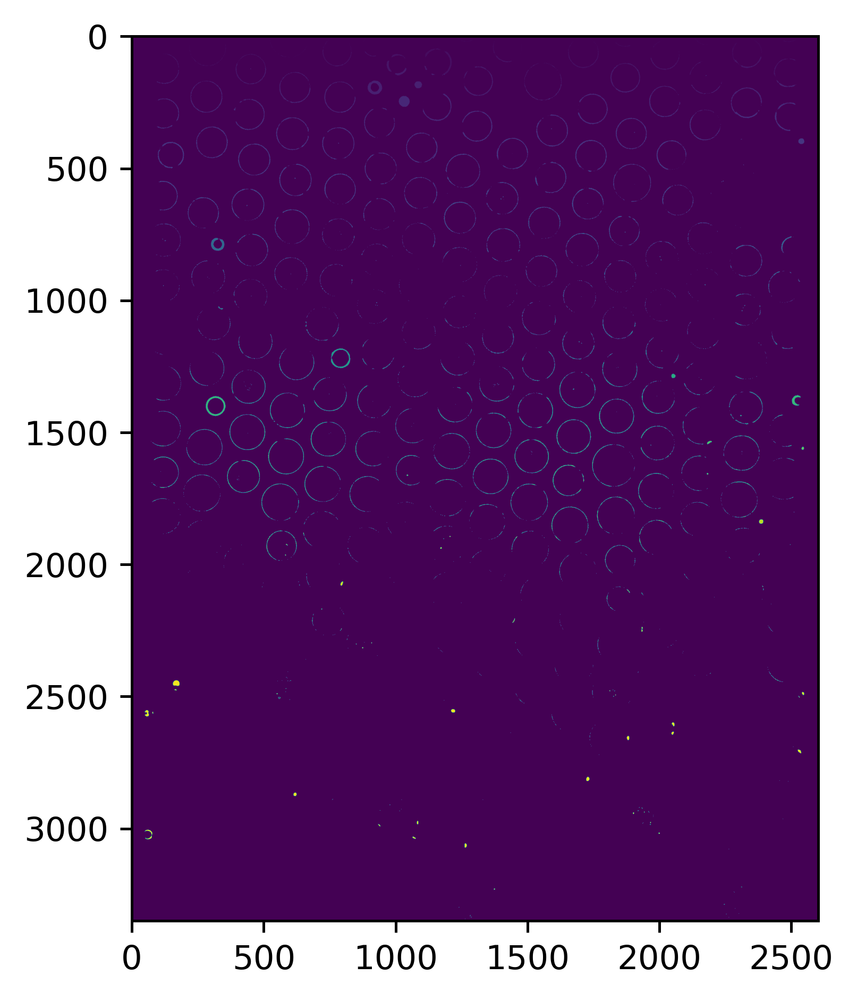

In [335]:
plt.imshow(labeled_features)
plt.show()

In [337]:
#TODO: Plot distribution of size of patches
np.unique(labeled_features)

array([   0,    1,    2, ..., 9674, 9675, 9676], dtype=int32)

# Enscibe bright patches with boxes

In [338]:
# get square coordinates of features
feature_squares = []
feature_points = []

# X and Y naming is a bit wierd here
for feat in range(1, num_features + 1):
    feat_coords = np.argwhere(labeled_features == feat)
    #TODO: Do something to remove features that are only a coupple of pixels
    if len(feat_coords) > elimination_threshold:
        feature_points.append(feat_coords)
        x_coords = feat_coords[:,0]
        y_coords = feat_coords[:,1]
        x_axis = [min(x_coords), max(x_coords)]
        y_axis = [min(y_coords), max(y_coords)]
        feature_squares.append([y_axis, x_axis])
    

<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

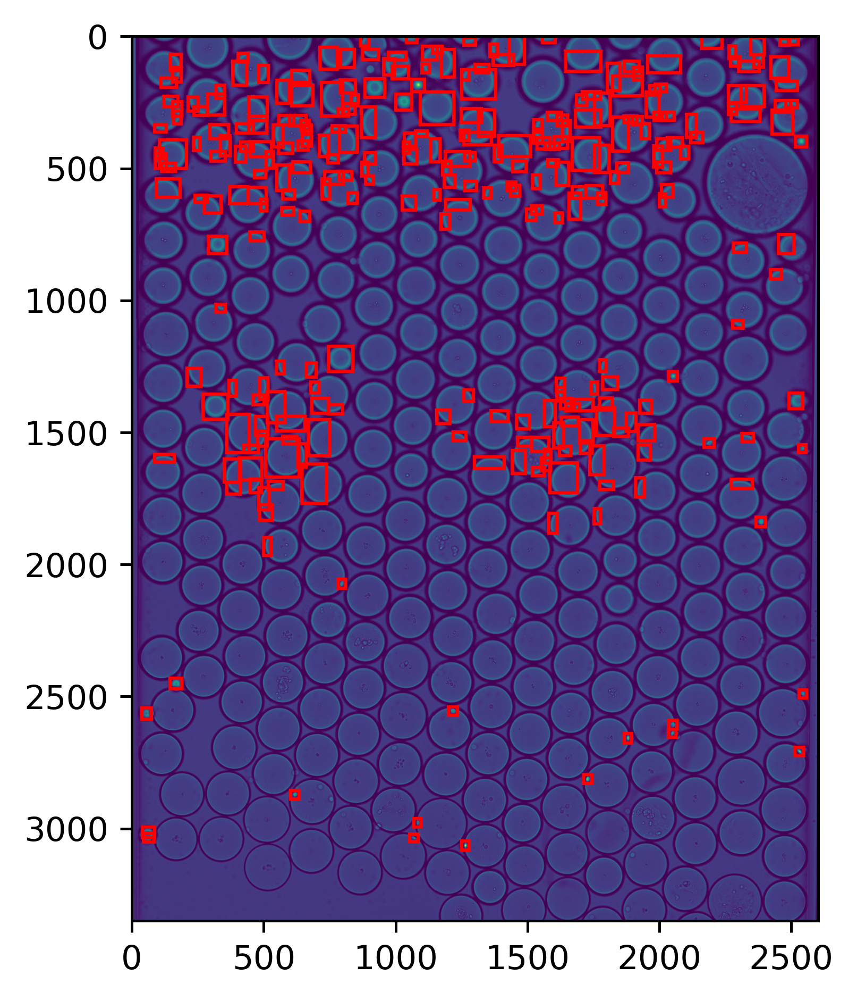

In [339]:
import matplotlib.patches as patches

plt.figure(figsize = (len(mask[0]), len(mask[1])))

fig, ax = plt.subplots()

#rect = patches.Rectangle((50, 100), 40, 30, linewidth=1, edgecolor='r', facecolor='none')
#ax.add_patch(rect)

# How much to enlarge each square in each direction to make interior more visible

for rect in feature_squares:
    rect = patches.Rectangle( (rect[0][0] - padding_squares//2, rect[1][0] - padding_squares//2), (rect[0][1]- rect[0][0] + padding_squares), (rect[1][1]-rect[1][0] + padding_squares), linewidth=1, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

plt.imshow(test)
#plt.savefig('books_read2.png')
plt.show()

# Compute circular regions around identified patches

In [340]:
def circle_rect(rectangle):
    a = abs(rectangle[0][0] - rectangle[0][1])
    b = abs(rectangle[1][0] - rectangle[1][1])
    r = 0.5 * math.sqrt(a**2 + b **2)
    c = (rectangle[0][1] - a//2, rectangle[1][1] - b//2)
    return [c, r]

In [341]:
# convert rectangles into circles
# sqrt(a^2 + b^2)
feature_circles = []

for rect in feature_squares:
    feature_circles.append(circle_rect(rect))

<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

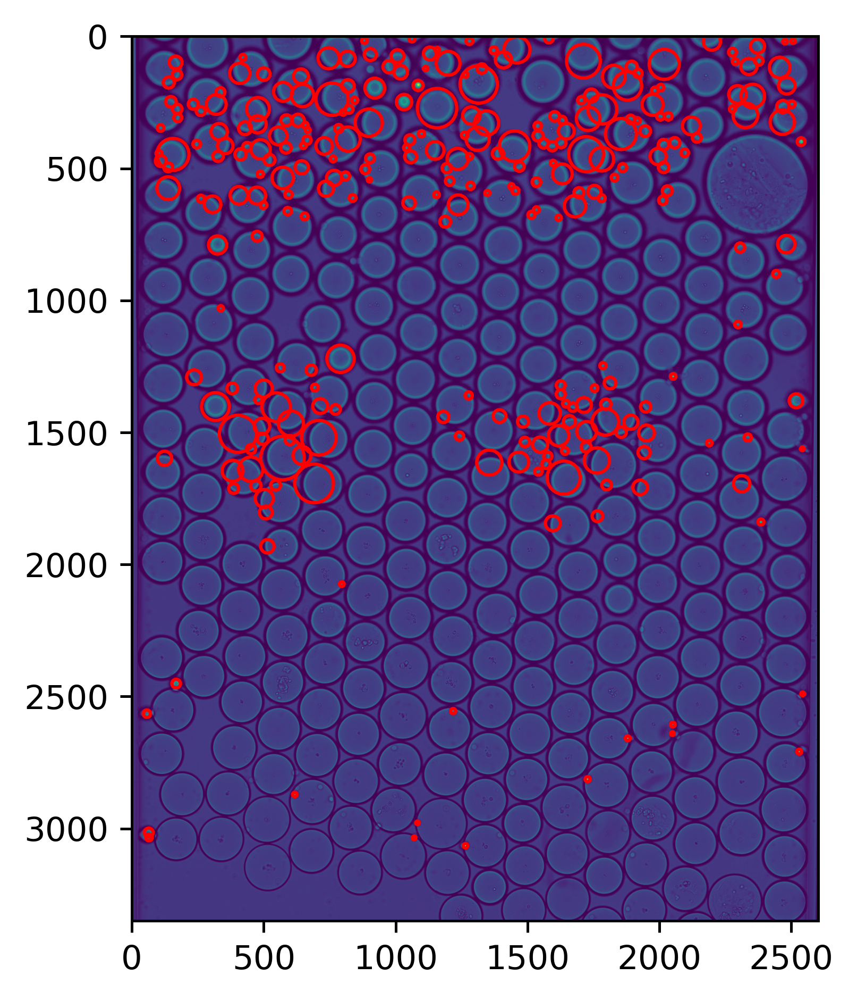

In [342]:
import matplotlib.patches as patches

#rect = patches.Rectangle((50, 100), 40, 30, linewidth=1, edgecolor='r', facecolor='none')
#ax.add_patch(rect)

def plot_circles(feature_circles, colors, padding = 10, plot=False, fname='defaultname.png'):
    plt.figure(figsize = (len(mask[0]), len(mask[1])))

    fig, ax = plt.subplots()

    for i in range(len(feature_circles)):
        patch = patches.Circle( feature_circles[i][0], feature_circles[i][1] + padding, linewidth=1, edgecolor=colors[i], facecolor='none')
        ax.add_patch(patch)

    plt.imshow(test)
    if plot:
        plt.savefig(fname)
    plt.show()
    
plot_circles(feature_circles, ['r'] * len(feature_circles), padding_circles_visual )

# Remove mislabelled edges based on circularity heuristics

In [343]:
def circle_weight(circle, points):
    # Get how many points should be in the circle
    
    # we could easily approximate this
    denom = round(circle[1]**2 * np.pi) // 1
    # Return fraction represented in points
    return len(points) / denom

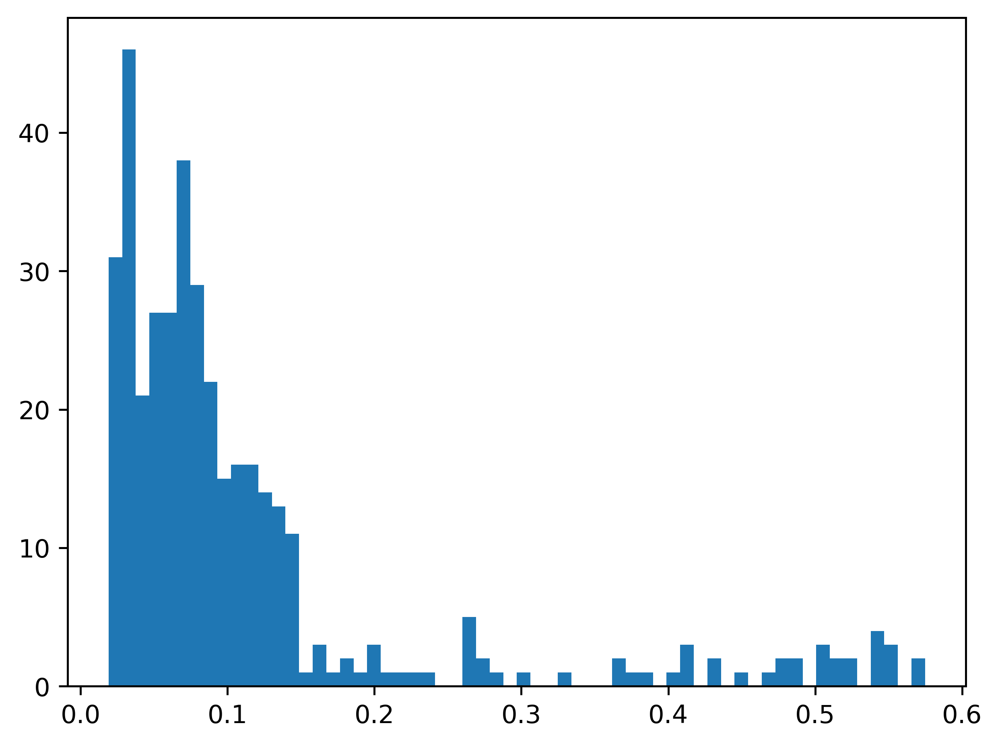

In [344]:
plt.hist(scores, bins = 60)
plt.show()

# Cutting between the peaks at 0.1 doesn't pick up the
# sattelites that we're cut in half

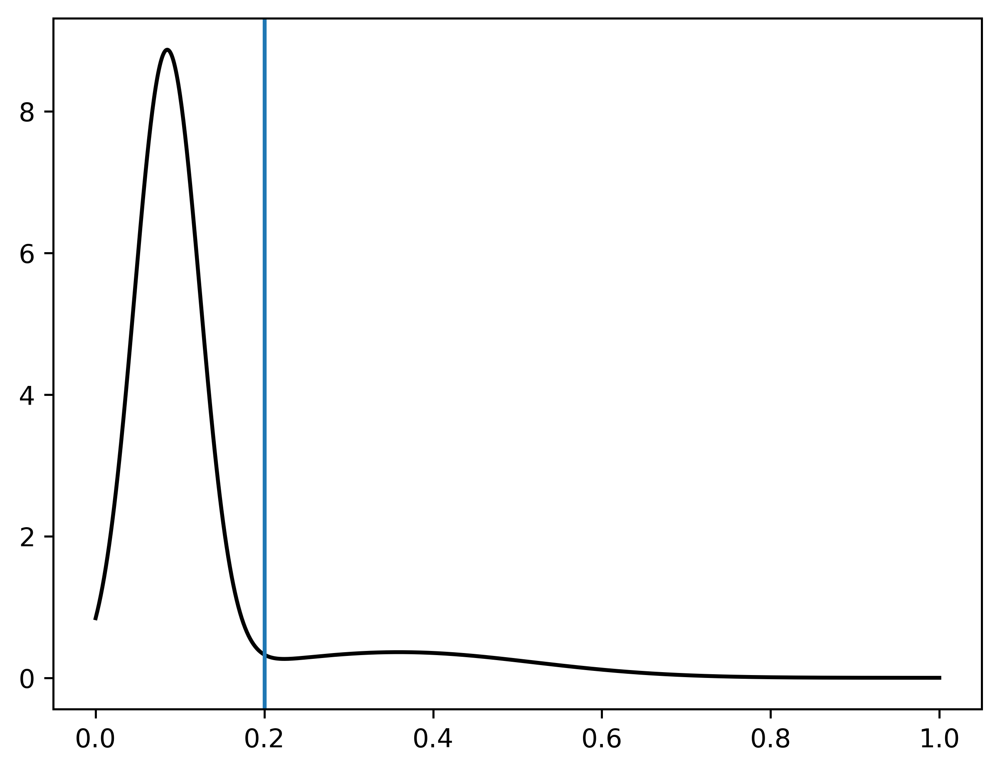

In [370]:
# select smark circle_weight_threshold
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=2, random_state=0)

gm.fit(np.array(scores).reshape(-1, 1))

x_den = np.linspace(0, 1, num=100)
y_lab = gm.predict(x_den.reshape(-1, 1))

decision_boundary = np.where(y_lab[:-1] != y_lab[1:])[0][0] + 2

if auto_circle_weight_threshold:
    circle_weight_threshold = decision_boundary / 100

fig = plt.figure()
ax = fig.add_subplot(111)

x = np.linspace(0, 1, 1000).reshape(1000,1)
logprob = gm.score_samples(x)
pdf = np.exp(logprob)

ax.plot(x, pdf, '-k')
plt.axvline(x=circle_weight_threshold)
plt.show()


In [346]:
# Mark, remove  and plot circles that don't fit this threshold
# Yellow circes are eliminated at this threshold

mask_cw = []
scores = []
fil_circles = []
fil_points = []

for i in range(len(feature_circles)):
    score = circle_weight(feature_circles[i], feature_points[i])
    scores.append(score)
    if score < circle_weight_threshold:
        mask_cw.append('y')
    else:
        mask_cw.append('r')
        fil_circles.append(feature_circles[i])
        fil_points.append(feature_points[i])



<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

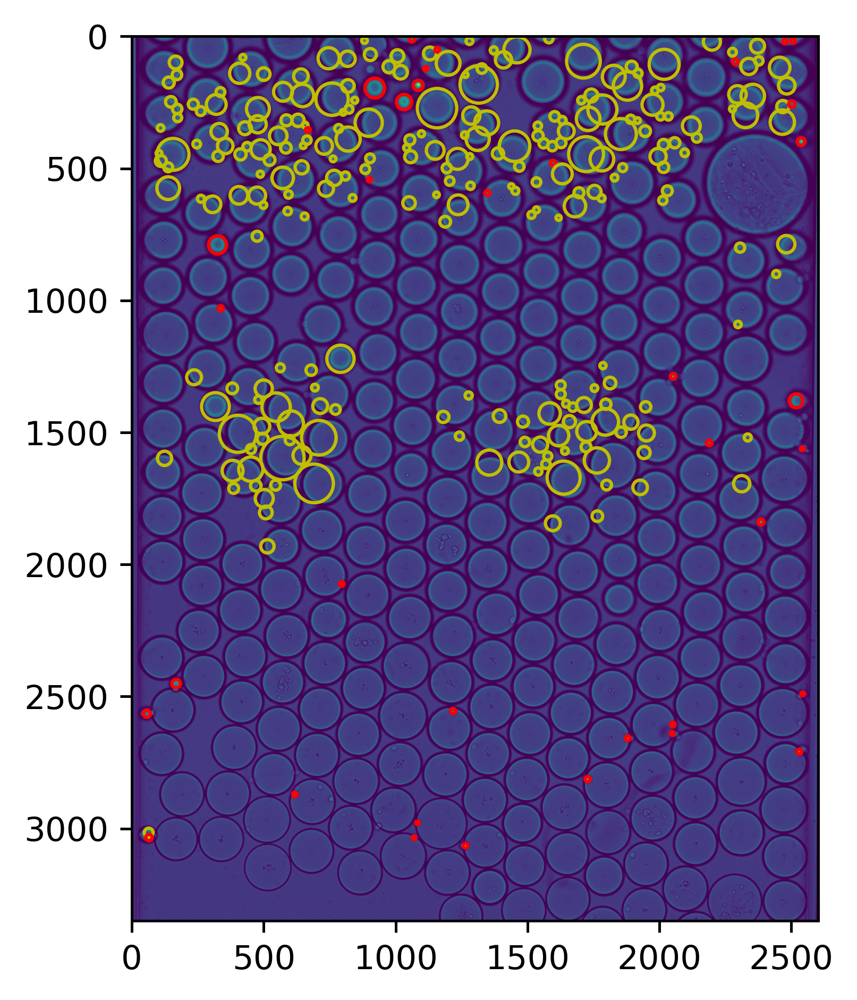

In [347]:
plot_circles(feature_circles, mask_cw, padding_circles_visual, plot=False, fname= 'cleaned_up.png')

<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

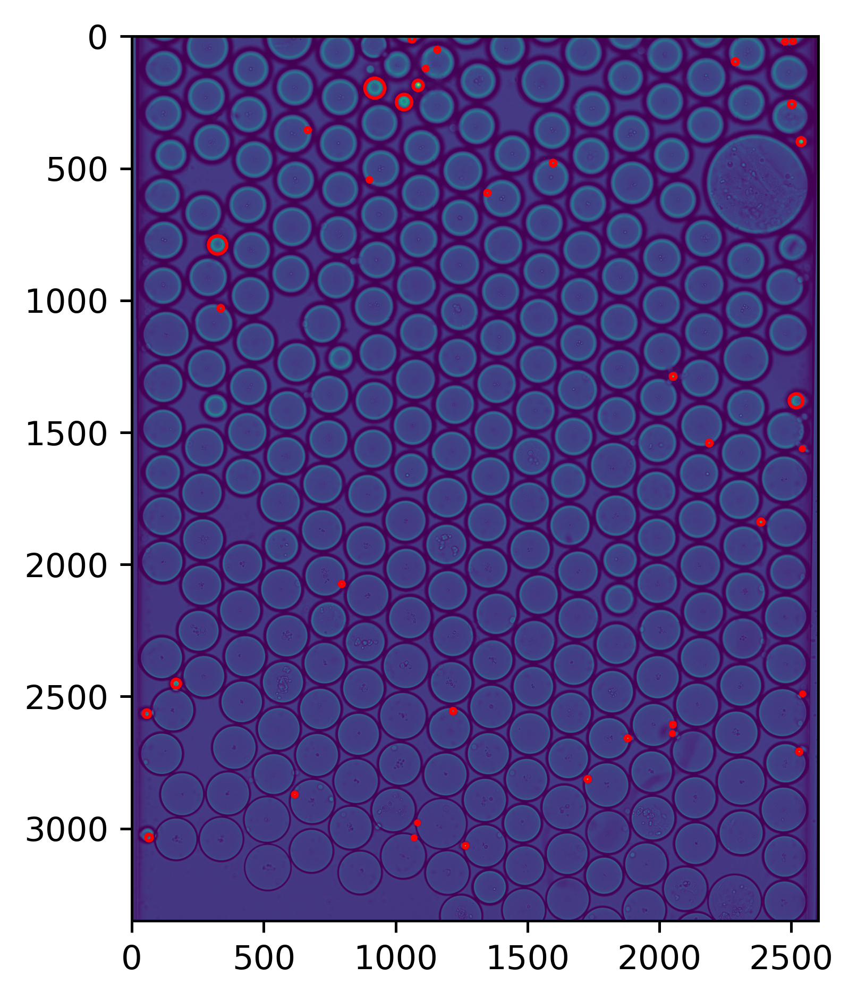

In [348]:
plot_circles(fil_circles, colors = ['r'] * len(fil_circles), padding = padding_circles_visual, plot=False, fname= 'cleaned_up.png')

# Merge overlapping regions based on padded cirle collision

In [350]:
intersect_matrix = np.zeros((len(fil_circles), len(fil_circles)))


for x in range(len(fil_circles)):
    #only need to compute half and no diagonals
    for y in range(len(fil_circles)):
        if x == y:
            continue
        # Two ifcles intersect if distance between center points is less than sum of radii
        dR1R2 = np.linalg.norm(np.subtract(fil_circles[x][0], fil_circles[y][0]))
        intersect_matrix[x][y] = (dR1R2 <= fil_circles[x][1] + fil_circles[y][1] + overlap_padding)
        intersect_matrix[y][x] = (dR1R2 <= fil_circles[x][1] + fil_circles[y][1]+ overlap_padding)

np.unique(intersect_matrix, return_counts=True)

(array([0., 1.]), array([1365,    4]))

<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

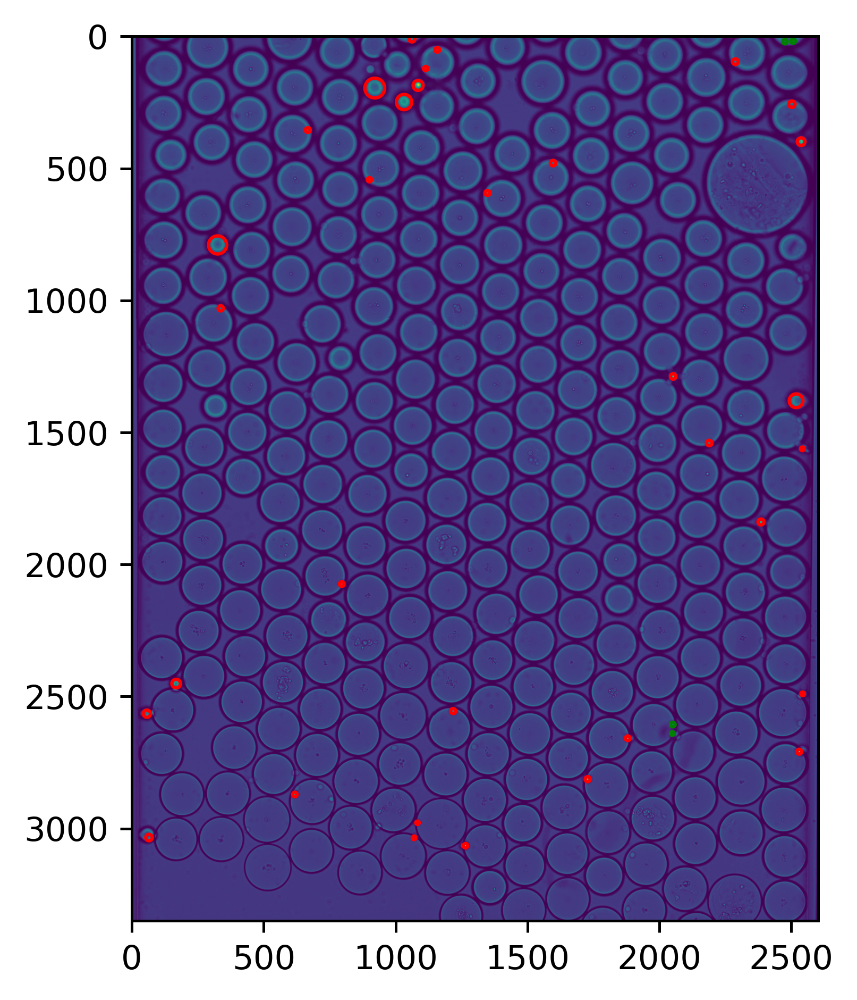

In [351]:
# Plot circles that were detected as intersecting with a different color

#rect = patches.Rectangle((50, 100), 40, 30, linewidth=1, edgecolor='r', facecolor='none')
#ax.add_patch(rect)

# How much to enlarge each square in each direction to make interior more visible

cols = [ 'g' if sum(a) > 0 else 'r' for a in intersect_matrix]
plot_circles(fil_circles, cols, padding_circles_visual)

In [352]:
# helper function identifies set of all overlapping circles of a circle in a BFS manner
def return_overlapping_set(vertex, adj_matrix):
    # Put initial adjacent vertecies in set and populate queue 
    queue = list(np.nonzero(adj_matrix[vertex]))[0]
    ol_set = [vertex]
    
    # while queue is not empty
    while len(queue) > 0:
        # pop vertex
        vert = queue[0]
        queue = queue[1:]
        
        # Ad vertex to visited set
        ol_set.append(vert)
        
        # Get adjacent to new vertes
        vert_adj = list(np.nonzero(adj_matrix[vert]))[0]
    return ol_set


In [353]:
# Get sets of overlapping circles
ol_circles = []
ol_points = []
ol_set = []
considered_verticies = []
mask_merged = []

# Copy intersect matrx
ol_intersect = intersect_matrix

for circ_index in range(len(fil_circles)):
    # If circle not overlapping with anyone
    if sum(ol_intersect[circ_index]) == 0:
        # Just put it in the output array
        ol_circles.append(fil_circles[circ_index])
        ol_points.append(fil_points[circ_index])
        mask_merged.append('r')
    else:
        # Theres some overlapping afoot!
        
        # If vertex already considered, ignore
        if circ_index in considered_verticies:
            continue
        # Get indecies of all overlapping circles
        new_ol_set = return_overlapping_set(circ_index, ol_intersect)
        
        ol_set.append(new_ol_set)
        considered_verticies = considered_verticies + new_ol_set
        
        # Merge point clouds in new_ol_set
        new_points = fil_points[new_ol_set[0]]
        for i in new_ol_set[1:]:
            new_points = list(new_points) + list(fil_points[i])
        ol_points.append(new_points)
        
        # Compute new boxes
        x_coords = np.array(new_points)[:,0]
        y_coords = np.array(new_points)[:,1]
        x_axis = [min(x_coords), max(x_coords)]
        y_axis = [min(y_coords), max(y_coords)]
        new_box = [y_axis, x_axis]

        ol_circles.append(circle_rect(new_box))
        mask_merged.append('g')
        
        

<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

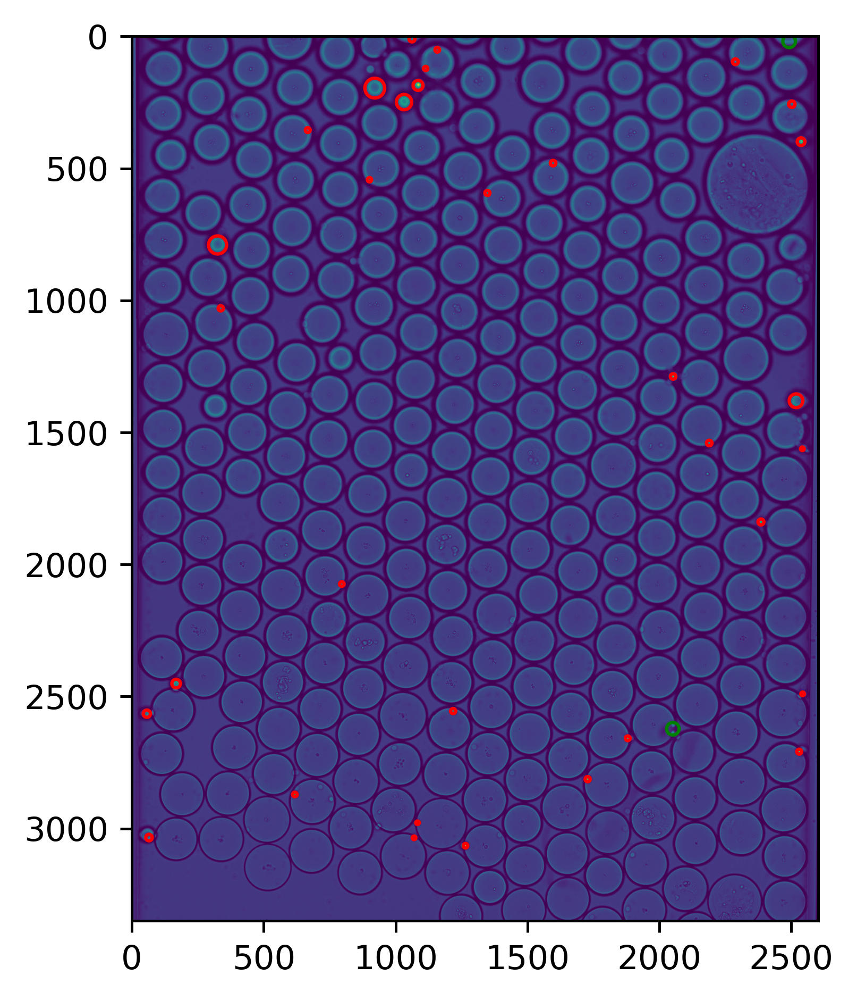

In [354]:
plot_circles(ol_circles, mask_merged, padding_circles_visual)

<Figure size 1.17135e+06x1.17135e+06 with 0 Axes>

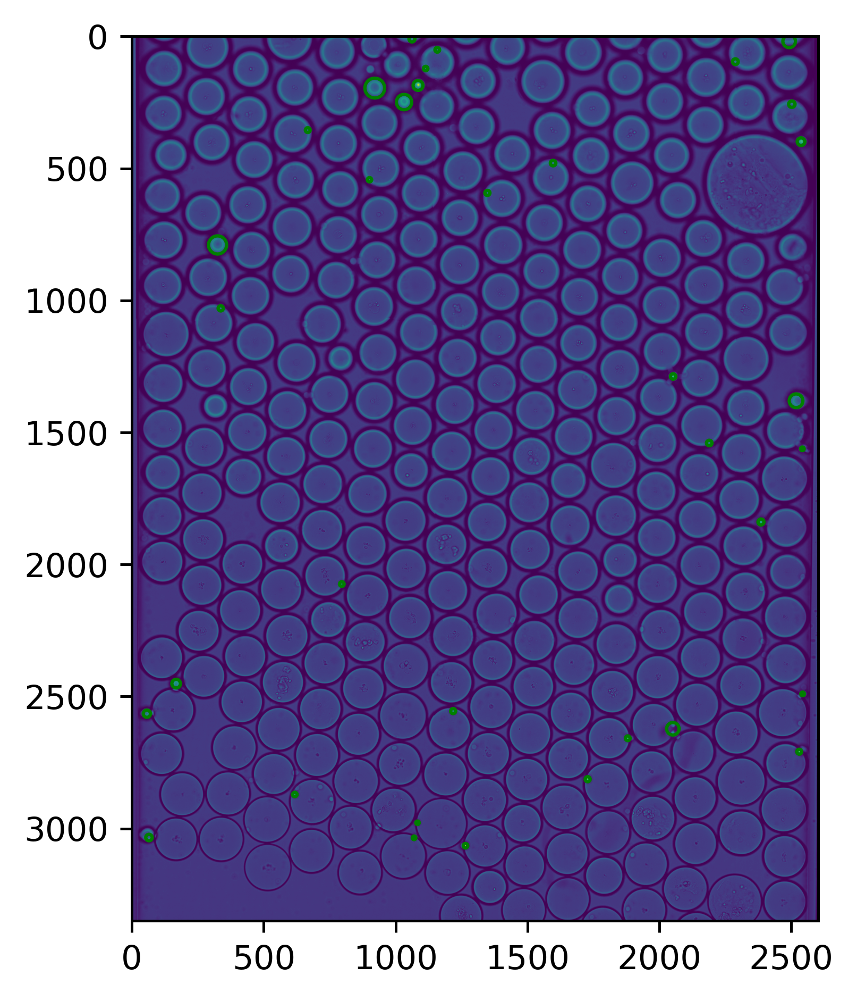

In [355]:
# mask zeros
mz = []
for circ in range(len(ol_circles)):
    if mask_merged[circ] == 'g' and ol_circles[circ][1] == 0.0:
        mz.append('y')
    elif ol_circles[circ][1] == 0.0:
        mz.append('r')
    else:
        mz.append('g')

plot_circles(ol_circles, mz, padding_circles_visual)

sf

# Perform Masking and Inpainting on identified regions

In [356]:
#!pip install opencv-python

In [357]:
import cv2

In [358]:
# Select intainting algorithm to use
# Options are:
#cv2.INPAINT_TELEA
#cv2.INPAINT_NS

flags = cv2.INPAINT_TELEA
flags = cv2.INPAINT_NS


In [359]:
# Process image to cv2 grayscale image (normalize values to 0, 255)

gs_image = test
max_val = gs_image.max()
gs_image = (gs_image / gs_image.max()) * 255
gs_image = np.array(gs_image, dtype = np.uint8)

In [360]:
def create_circular_mask(h, w, center, radius):
    
    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)

    mask = dist_from_center <= radius
    return mask

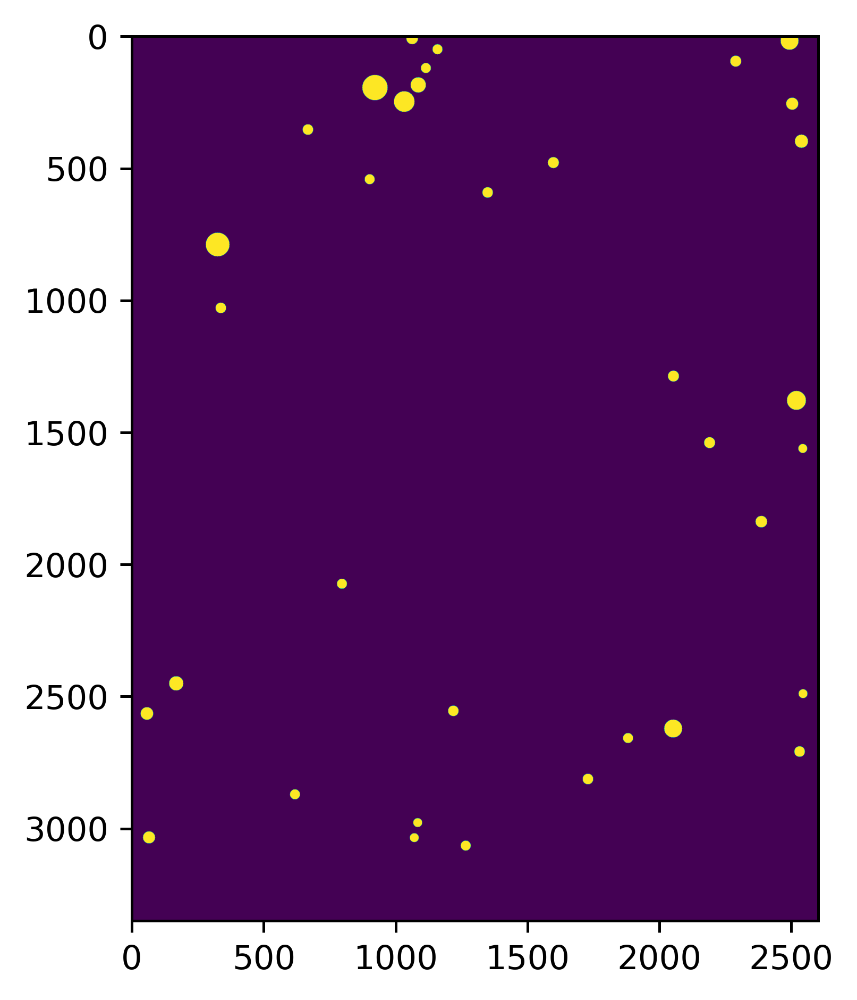

In [361]:
# Generate mask, mask should be a single channel grayscale image, with 0 for leave alone and 1 for replace

# Generate empty array
ip_mask = np.zeros(gs_image.shape)

# For each circle, paint it in the mask
for circle in ol_circles:
    cv2.circle(ip_mask, circle[0], math.ceil(circle[1]) + circle_mask_padding ,255,-1)

ip_mask =  np.array(ip_mask, dtype = np.uint8)
plt.imshow(ip_mask)
plt.show()


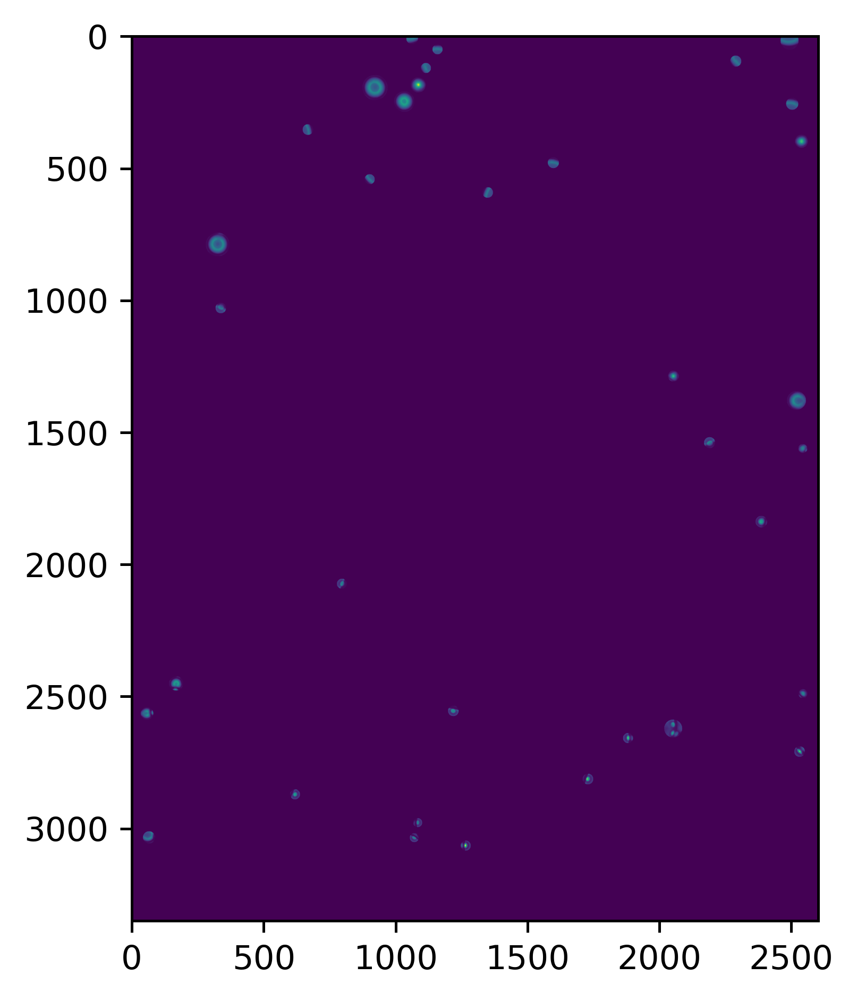

In [362]:
# A rather nice visualisation of what is masked out
mask_content = cv2.bitwise_and(gs_image, gs_image, mask = ip_mask)

plt.imshow(mask_content)
plt.show()

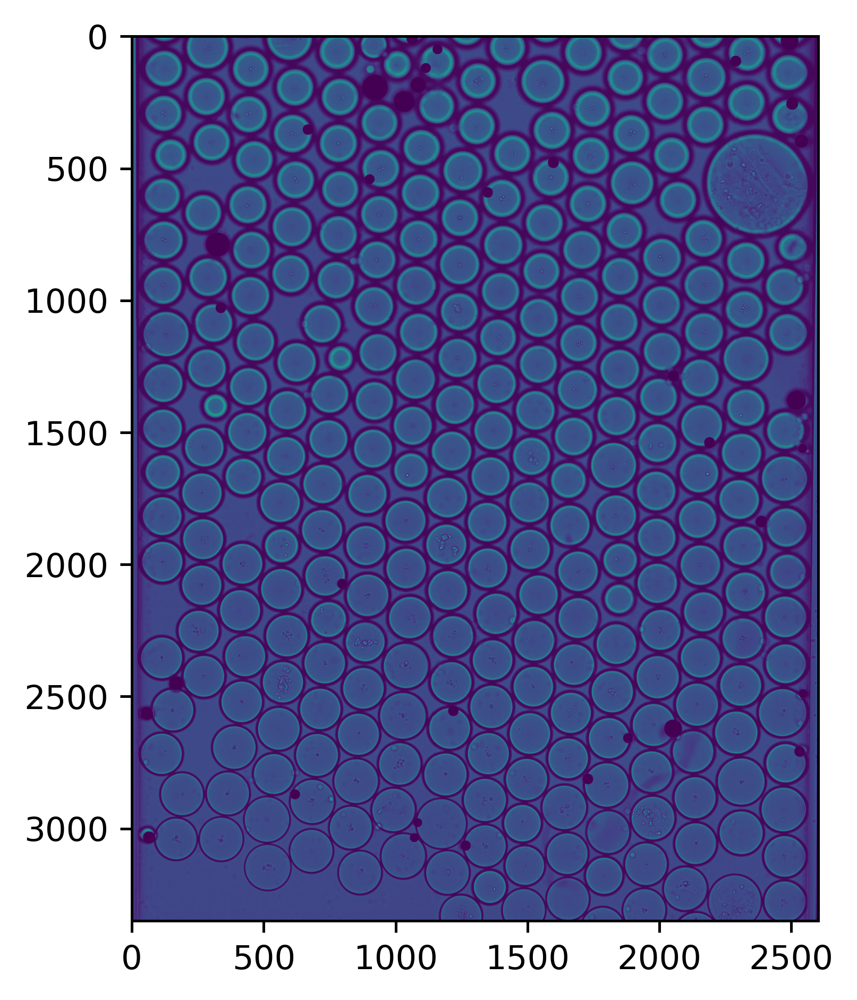

In [363]:
masked_image = cv2.bitwise_and(gs_image, gs_image, mask = cv2.bitwise_not(ip_mask))

plt.imshow(masked_image)
plt.show()

In [364]:
# Perform inpainting
#TODO: use global inpaint_radius
ip_output = cv2.inpaint(gs_image, ip_mask, inpaint_radius, flags=flags)


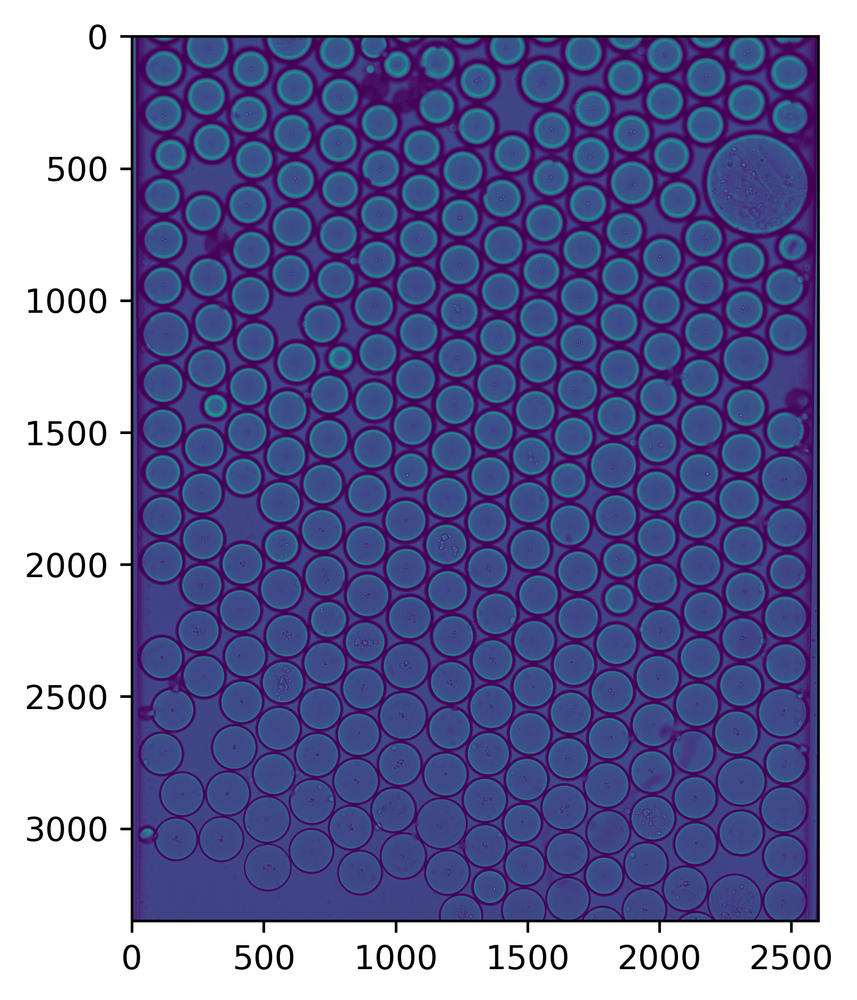

In [365]:
plt.imshow(ip_output)
plt.show()

# TODO:
    
- Merge overlapping squares
- Fourier transform for edge detection
- Adjust threshold for brightness and minimum size of detected point
- Use some metric to check for cirularity -- -average distance from circle
We doing stats nao
https://en.wikipedia.org/wiki/Circular_uniform_distribution
- Look at gradient to see if line or droplet
- Increase contrast for easier picking of thresholds

Not good if full radius
https://pubsonline.informs.org/doi/pdf/10.1287/trsc.25.1.83
Check distance of weighting point o point cloud from center of cirlce 
Max vs. Avg/Min distance


In [366]:
Ensambles of models with different preprocessing -- Boosting


SyntaxError: invalid syntax (2459802749.py, line 1)

In [ ]:
sum(intersect_matrix[66])

In [ ]:
# LaMa Inpainting

LaMa Inpainting
https://github.com/saic-mdal/lama/tree/main/models

Slightly outdated literature review
https://link.springer.com/article/10.1007/s11063-019-10163-0\

DeepFill
https://github.com/nipponjo/deepfillv2-pytorch

In [ ]:
feature_circles